In [2]:
import os
import torch
import torchvision.models as models
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from google.colab import drive

In [3]:
class image_data_set(torch.utils.data.Dataset):
    def __init__(self, data, labels):
        self.data = data
        self.labels = labels
  
    def __len__(self):
        return len(self.data)
  
    def __getitem__(self, index):
        return {'data': self.data[index], 'label': self.labels[index]}

In [4]:
def print_data_analysis(present_lighting_sufficient_data, 
                        present_lighting_insufficient_data, 
                        not_present_lighting_sufficient_data, 
                        not_present_lighting_insufficient_data):
  
    subplot = plt.subplot()
    data_lengthes = np.array([
        [len(present_lighting_sufficient_data), len(present_lighting_insufficient_data)], 
        [len(not_present_lighting_sufficient_data), len(not_present_lighting_insufficient_data)]
    ])
    sns.heatmap(data_lengthes, annot=True, fmt='g', cmap='Blues')
    subplot.xaxis.set_ticklabels(['Lighting Sufficient', 'Lighting Not Sufficient'])
    subplot.yaxis.set_ticklabels(['Wildlife Present', 'No Wildlife Present'])
    plt.show()

def get_image_tensor(file_path):
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
    
    image = Image.open(file_path)
    return transform(image)

def get_data_and_labels(directory_path, label):
    image_tensors, labels = [], []
    for file in os.listdir(directory_path):
        if file.endswith(".JPG"):
            file_path = directory_path + file
            image_tensor = get_image_tensor(file_path)

            image_tensors.append(image_tensor)
            labels.append(label)
            
    return image_tensors, labels

def get_data_for_label(file_pathes, label): 

  all_data, all_labels = [], []
  for file_path in file_pathes:
      data, labels = get_data_and_labels(file_path, label)
      all_data.extend(data)
      all_labels.extend(labels)

  return all_data, all_labels
    
def get_data_sets(present_file_pathes_lighting_sufficient, 
                  present_file_pathes_lighting_insufficient,
                  not_present_file_pathes_lighting_sufficient,
                  not_present_file_pathes_lighting_insufficient): 

    present_ls_data, present_ls_labels = get_data_for_label(present_file_pathes_lighting_sufficient, 1)
    present_lis_data, present_lis_labels = get_data_for_label(present_file_pathes_lighting_insufficient, 1)
    not_present_ls_data, not_present_ls_labels = get_data_for_label(not_present_file_pathes_lighting_sufficient, 0)
    not_present_lis_data, not_present_lis_labels = get_data_for_label(not_present_file_pathes_lighting_insufficient, 0)

    print_data_analysis(present_ls_data, present_lis_data, not_present_ls_data, not_present_lis_data)
    
    ls_data = present_ls_data + not_present_ls_data
    ls_labels = present_ls_labels + not_present_ls_labels

    lis_data = present_lis_data + not_present_lis_data
    lis_labels = present_lis_labels + not_present_lis_labels
    
    ls_training_data, ls_testing_data, ls_training_labels, ls_testing_labels = train_test_split(ls_data, ls_labels)
    lis_training_data, lis_testing_data, lis_training_labels, lis_testing_labels = train_test_split(lis_data, lis_labels)

    training_data = ls_training_data + lis_training_data
    testing_data = ls_testing_data + lis_testing_data
    training_labels = ls_training_labels + lis_training_labels
    testing_labels = ls_testing_labels + lis_testing_labels
    
    print("\nNumber of training photos: " + str(len(training_data)))
    print("Number of testing photos: " + str(len(testing_data)))
    print("Number of lighting sufficient testing photos: " + str(len(ls_testing_data)))
    print("Number of lighting insufficient testing photos: " + str(len(lis_testing_data)))
    
    training_data_set = image_data_set(training_data, training_labels)
    testing_data_set = image_data_set(testing_data, testing_labels)
    ls_testing_data_set = image_data_set(ls_testing_data, ls_testing_labels)
    lis_testing_data_set = image_data_set(lis_testing_data, lis_testing_labels)
    
    return training_data_set, testing_data_set, ls_testing_data_set, lis_testing_data_set

def get_loaders(training_data_set, testing_data_set, ls_testing_data_set, lis_testing_data_set, batch_size):
    training_loader = torch.utils.data.DataLoader(dataset = training_data_set,
                                                  batch_size = batch_size,
                                                  shuffle = True)

    testing_loader = torch.utils.data.DataLoader(dataset = testing_data_set,
                                                 batch_size = batch_size,
                                                 shuffle = True)
    
    ls_testing_loader = torch.utils.data.DataLoader(dataset = ls_testing_data_set,
                                                 batch_size = batch_size,
                                                 shuffle = True)
    
    lis_testing_loader = torch.utils.data.DataLoader(dataset = lis_testing_data_set,
                                                 batch_size = batch_size,
                                                 shuffle = True)
    
    return training_loader, testing_loader, ls_testing_loader, lis_testing_loader

In [5]:
def print_image(image_tensor, prediction):
    if(prediction == 1):
        prediction_string = "Wildlife Present"
    else:
        prediction_string = "No Wildlife Present"

    #Alternative normalized RGB visualization: plt.imshow(image_tensor.cpu().permute(1, 2, 0).numpy())
    plt.imshow(image_tensor[0].cpu(), cmap="gray")
    plt.title("Incorrectly Predicted " + prediction_string) 
    plt.show()

def print_testing_analysis(all_labels, all_predictions, title):
    subplot = plt.subplot()

    cf_matrix = confusion_matrix(all_labels, all_predictions, labels=[1, 0])
    sns.heatmap(cf_matrix, annot=True, fmt='g', cmap='Blues')

    subplot.set_xlabel('Predictions')
    subplot.set_ylabel('Labels')
    subplot.set_title(title + ' Testing Confusion Matrix')
    subplot.xaxis.set_ticklabels(['Wildlife Present', 'No Wildlife Present'])
    subplot.yaxis.set_ticklabels(['Wildlife Present', 'No Wildlife Present'])
    plt.show()

    accuracy = accuracy_score(all_labels, all_predictions)
    print(title + " Accuracy: " + str(accuracy))

    precision, recall, f_score, support = precision_recall_fscore_support(all_labels, all_predictions, average='binary')
    print(title + " Precision: " + str(precision))
    print(title + " Recall: " + str(recall))
    print(title + " F-Score: " + str(f_score))

def train(model, training_loader, criterion, optimizer):
    model.train()
    running_loss = 0.0
    num_correct = 0
    for i, data in enumerate(training_loader):
        data, labels = data['data'].to(device), data['label'].to(device)
        optimizer.zero_grad()
        output = model(data)
        loss = criterion(output, labels)
        running_loss += loss.item()
        _, predictions = torch.max(output.data, 1)
        num_correct += (predictions == labels).sum().item()
        loss.backward()
        optimizer.step()
    
    loss = running_loss/len(training_loader.dataset)
    accuracy = num_correct/len(training_loader.dataset)
    return loss, accuracy

def test(model, testing_loader, criterion, print_incorrect_images):
    model.eval()
    running_loss = 0.0
    num_correct = 0
    all_labels, all_predictions = [], []

    for i, data in enumerate(testing_loader):
        data, labels = data['data'].to(device), data['label'].to(device)
        output = model(data)
        loss = criterion(output, labels)
        running_loss += loss.item()
        _, predictions = torch.max(output.data, 1)
        for index, prediction in enumerate(predictions):
            if(prediction == labels[index]):
                num_correct += 1
            elif(print_incorrect_images):
                print_image(data[index], prediction)

        all_labels.extend(labels.cpu())
        all_predictions.extend(predictions.cpu())
    
    loss = running_loss/len(testing_loader.dataset)
    accuracy = num_correct/len(testing_loader.dataset)
    return loss, accuracy, all_labels, all_predictions

In [6]:
def train_and_test(model, training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device):
    model.to(device)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)
    
    for epoch in range(5):
        print("epoch: " + str(epoch))
        
        training_loss, training_accuracy = train(model, training_loader, criterion, optimizer)
        print("training loss: " + str(training_loss) + " and training accuracy: " + str(training_accuracy))
        
        testing_loss, testing_accuracy, _, _ = test(model, testing_loader, criterion, False)
        print("testing loss: " + str(testing_loss) + " and testing accuracy: " + str(testing_accuracy))

    testing_loss, testing_accuracy, labels, predictions = test(model, testing_loader, criterion, True)
    print_testing_analysis(labels, predictions, "Overall")

    testing_loss, testing_accuracy, labels, predictions = test(model, ls_testing_loader, criterion, False)
    print_testing_analysis(labels, predictions, "Lighting Sufficient")

    testing_loss, testing_accuracy, labels, predictions = test(model, lis_testing_loader, criterion, False)
    print_testing_analysis(labels, predictions, "Lighting Insufficient")

In [12]:
def train_and_test_VGG11(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes):
    print("\nTraining and Testing VGG11")
    vgg11 = models.vgg11(weights = models.VGG11_Weights.DEFAULT)
    vgg11.classifier[6].out_features = num_classes
    train_and_test(vgg11, training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device)

def train_and_test_VGG19(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes):
    print("\nTraining and Testing VGG19")
    vgg19 = models.vgg19(weights = models.VGG19_Weights.DEFAULT)
    vgg19.classifier[6].out_features = num_classes
    train_and_test(vgg19, training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device)

def train_and_test_ResNet50(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes):
    print("\nTraining and Testing ResNet50")
    resnet50 = models.resnet50(weights = models.ResNet50_Weights.DEFAULT)
    resnet50.fc.out_features = num_classes
    train_and_test(resnet50, training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device)

def train_and_test_ResNet152(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes):
    print("\nTraining and Testing ResNet152")
    resnet152 = models.resnet152(weights = models.ResNet152_Weights.DEFAULT)
    resnet152.fc.out_features = num_classes
    train_and_test(resnet152, training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device)
    
def train_and_test_AlexNet(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes):
    print("\nTraining and Testing AlexNet")
    alexnet = models.alexnet(weights = models.AlexNet_Weights.DEFAULT)
    alexnet.classifier[6].out_features = num_classes
    train_and_test(alexnet, training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device)

def train_and_test_ViT_B_16(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes):
    print("\nTraining and Testing Vision Transformer Base 16")
    vit_b_16 = models.vit_b_16(weights = models.ViT_B_16_Weights.IMAGENET1K_V1)
    train_and_test(vit_b_16, training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device)

def train_and_test_ViT_B_32(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes):
    print("\nTraining and Testing Vision Transformer Base 32")
    vit_b_32 = models.vit_b_32(weights = models.ViT_B_32_Weights.IMAGENET1K_V1)
    train_and_test(vit_b_32, training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device)

def train_and_test_ViT_L_16(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes):
    print("\nTraining and Testing Vision Transformer Large 16")
    vit_l_16 = models.vit_l_16(weights = models.ViT_L_16_Weights.IMAGENET1K_V1)
    train_and_test(vit_l_16, training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device)

def train_and_test_ViT_L_32(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes):
    print("\nTraining and Testing Vision Transformer Large 32")
    vit_l_32 = models.vit_l_32(weights = models.ViT_L_32_Weights.IMAGENET1K_V1)
    train_and_test(vit_l_32, training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device)

def train_and_test_ViT_H_14(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes):
    print("\nTraining and Testing Vision Transformer Huge 14")
    vit_h_14 = models.vit_h_14(weights = models.ViT_H_14_Weights.IMAGENET1K_SWAG_E2E_V1)
    train_and_test(vit_h_14, training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device)

#Orchestration

In [8]:
# Use this to connect to Google Drive in Google Colab
drive.mount('/content/drive')

# Use this to unzip file in Google Colab
!unzip -qq drive/MyDrive/manually_labeled_wildlife_data

Mounted at /content/drive


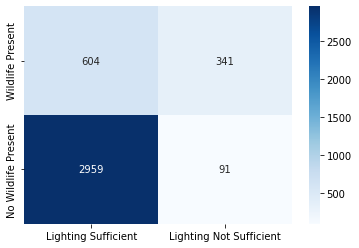


Number of training photos: 2996
Number of testing photos: 999
Number of lighting sufficient testing photos: 891
Number of lighting insufficient testing photos: 108


In [9]:
present_file_pathes_ls = [
  "manually_labeled_wildlife_data/MP152_ODOT009_REPELCAM/present/lighting_sufficient/",
  "manually_labeled_wildlife_data/MP152_ODOT003_EASTFACE/present/lighting_sufficient/"
]

present_file_pathes_lis = [
  "manually_labeled_wildlife_data/MP152_ODOT009_REPELCAM/present/lighting_insufficient/",
  "manually_labeled_wildlife_data/MP152_ODOT003_EASTFACE/present/lighting_insufficient/"
]

not_present_file_pathes_ls = [
  "manually_labeled_wildlife_data/MP152_ODOT009_REPELCAM/not_present/lighting_sufficient/",
  "manually_labeled_wildlife_data/MP152_ODOT003_EASTFACE/not_present/lighting_sufficient/",
]

not_present_file_pathes_lis = [
  "manually_labeled_wildlife_data/MP152_ODOT009_REPELCAM/not_present/lighting_insufficient/",
  "manually_labeled_wildlife_data/MP152_ODOT003_EASTFACE/not_present/lighting_insufficient/",
]

num_classes = 2
batch_size = 10

training_data_set, testing_data_set, ls_testing_data_set, lis_testing_data_set = get_data_sets(
    present_file_pathes_ls, 
    present_file_pathes_lis,
    not_present_file_pathes_ls,
    not_present_file_pathes_lis
)
training_loader, testing_loader, ls_testing_loader, lis_testing_loader = get_loaders(
    training_data_set, 
    testing_data_set, 
    ls_testing_data_set, 
    lis_testing_data_set, 
    batch_size
)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
torch.cuda.empty_cache()


Training and Testing VGG11


Downloading: "https://download.pytorch.org/models/vgg11-8a719046.pth" to /root/.cache/torch/hub/checkpoints/vgg11-8a719046.pth


  0%|          | 0.00/507M [00:00<?, ?B/s]

epoch: 0
training loss: 0.04137895638508615 and training accuracy: 0.880173564753004
testing loss: 0.017067987767343706 and testing accuracy: 0.944944944944945
epoch: 1
training loss: 0.01773479831176039 and training accuracy: 0.9309078771695594
testing loss: 0.015210700169867216 and testing accuracy: 0.9519519519519519
epoch: 2
training loss: 0.01432814927631148 and training accuracy: 0.94826435246996
testing loss: 0.010904056717407656 and testing accuracy: 0.955955955955956
epoch: 3
training loss: 0.012602156908794954 and training accuracy: 0.9472630173564753
testing loss: 0.009908588740821308 and testing accuracy: 0.9629629629629629
epoch: 4
training loss: 0.010067987463776839 and training accuracy: 0.9596128170894526
testing loss: 0.008898474976240186 and testing accuracy: 0.964964964964965


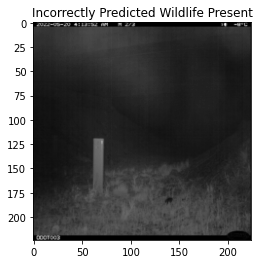

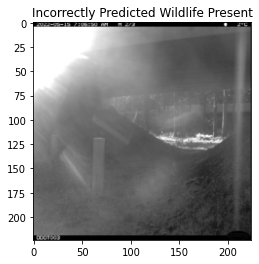

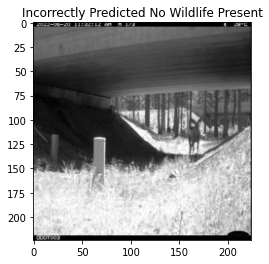

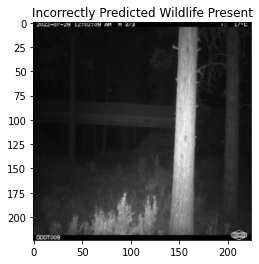

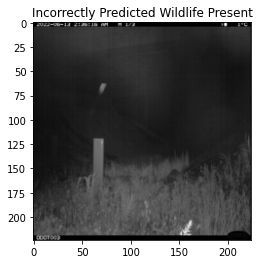

...

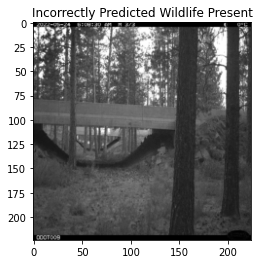

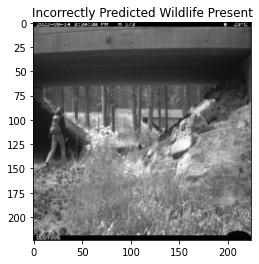

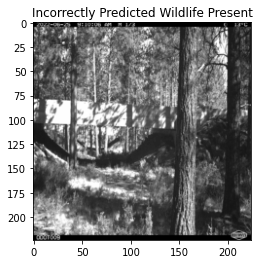

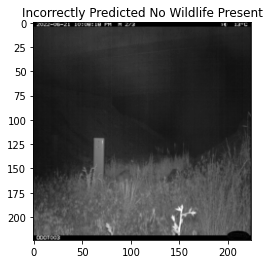

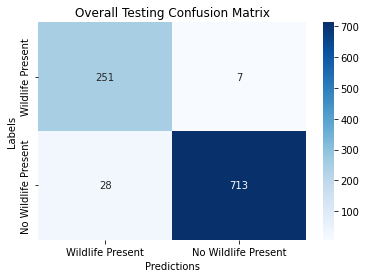

Overall Accuracy: 0.964964964964965
Overall Precision: 0.899641577060932
Overall Recall: 0.9728682170542635
Overall F-Score: 0.9348230912476723


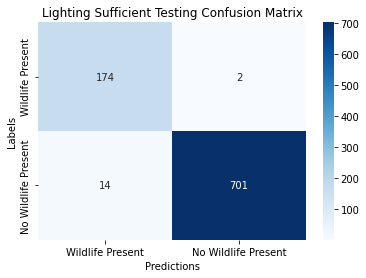

Lighting Sufficient Accuracy: 0.9820426487093153
Lighting Sufficient Precision: 0.925531914893617
Lighting Sufficient Recall: 0.9886363636363636
Lighting Sufficient F-Score: 0.9560439560439561


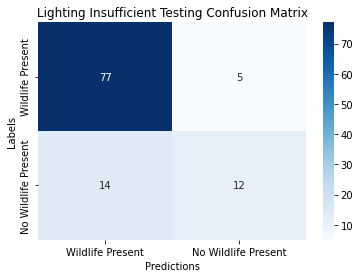

Lighting Insufficient Accuracy: 0.8240740740740741
Lighting Insufficient Precision: 0.8461538461538461
Lighting Insufficient Recall: 0.9390243902439024
Lighting Insufficient F-Score: 0.8901734104046243


In [ ]:
 train_and_test_VGG11(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes)


Training and Testing VGG19


Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

epoch: 0
training loss: 0.03507034895272431 and training accuracy: 0.8788384512683578
testing loss: 0.027294862295712555 and testing accuracy: 0.908908908908909
epoch: 1
training loss: 0.015216408827403603 and training accuracy: 0.9395861148197597
testing loss: 0.012103961469643787 and testing accuracy: 0.960960960960961
epoch: 2
training loss: 0.012289614811412365 and training accuracy: 0.9439252336448598
testing loss: 0.014483121281529322 and testing accuracy: 0.93993993993994
epoch: 3
training loss: 0.008678919055185455 and training accuracy: 0.9599465954606141
testing loss: 0.007331748532887868 and testing accuracy: 0.9679679679679679
epoch: 4
training loss: 0.007457524959640134 and training accuracy: 0.9662883845126836
testing loss: 0.007533363406755589 and testing accuracy: 0.964964964964965


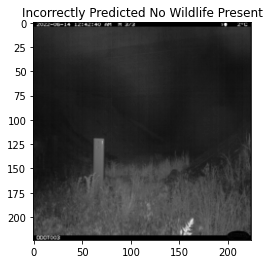

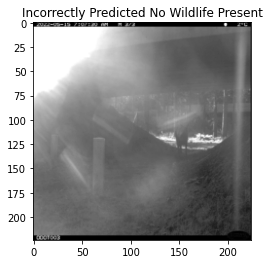

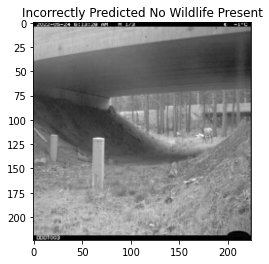

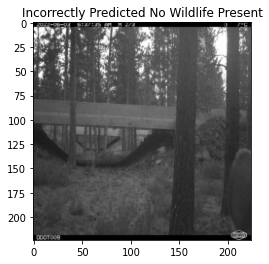

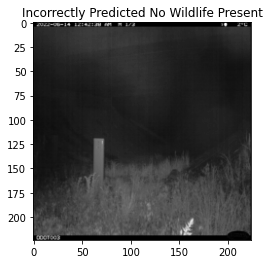

...

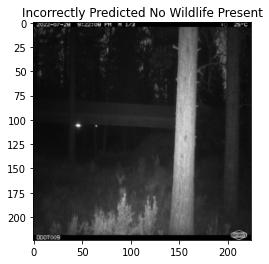

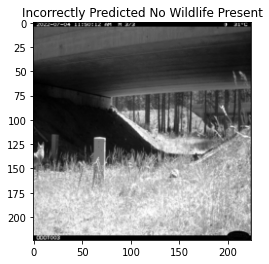

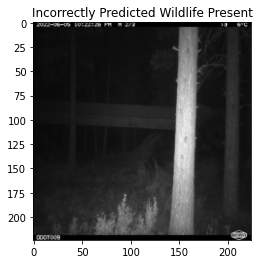

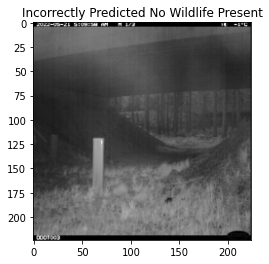

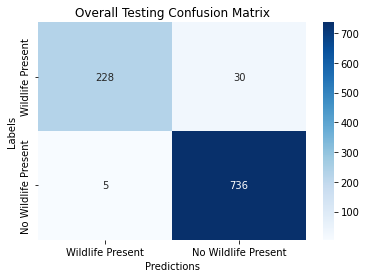

Overall Accuracy: 0.964964964964965
Overall Precision: 0.9785407725321889
Overall Recall: 0.8837209302325582
Overall F-Score: 0.9287169042769858


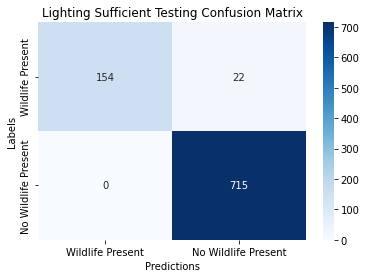

Lighting Sufficient Accuracy: 0.9753086419753086
Lighting Sufficient Precision: 1.0
Lighting Sufficient Recall: 0.875
Lighting Sufficient F-Score: 0.9333333333333333


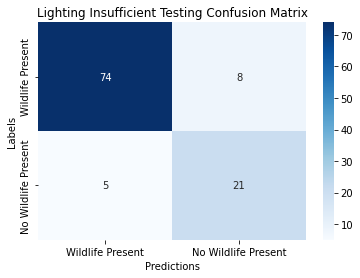

Lighting Insufficient Accuracy: 0.8796296296296297
Lighting Insufficient Precision: 0.9367088607594937
Lighting Insufficient Recall: 0.9024390243902439
Lighting Insufficient F-Score: 0.9192546583850932


In [ ]:
train_and_test_VGG19(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes)


Training and Testing ResNet50


Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

epoch: 0
training loss: 0.06900319344804277 and training accuracy: 0.8648197596795728
testing loss: 0.015025407983898162 and testing accuracy: 0.938938938938939
epoch: 1
training loss: 0.009930242941303251 and training accuracy: 0.9612817089452603
testing loss: 0.008943294438331185 and testing accuracy: 0.9569569569569569
epoch: 2
training loss: 0.00689638356845428 and training accuracy: 0.9753004005340454
testing loss: 0.006114438167065606 and testing accuracy: 0.970970970970971
epoch: 3
training loss: 0.005521664945986893 and training accuracy: 0.9779706275033377
testing loss: 0.006415455442985186 and testing accuracy: 0.973973973973974
epoch: 4
training loss: 0.0036145874355509797 and training accuracy: 0.985981308411215
testing loss: 0.005137544995898873 and testing accuracy: 0.975975975975976


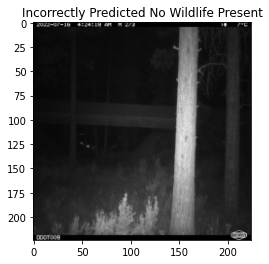

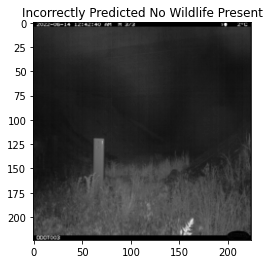

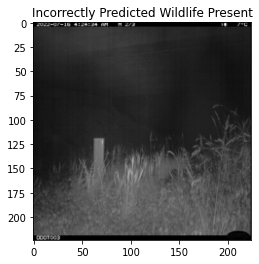

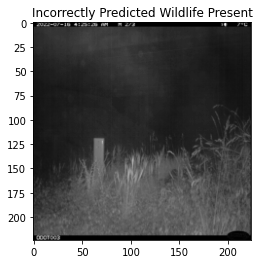

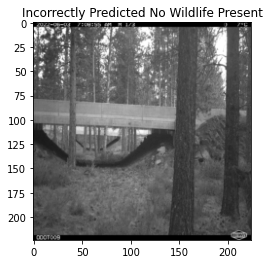

...

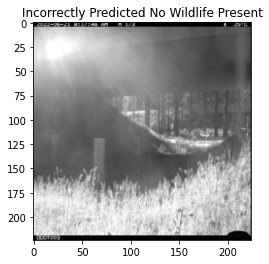

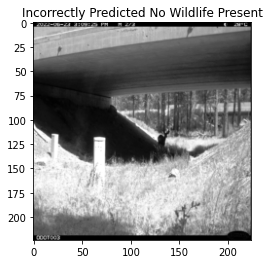

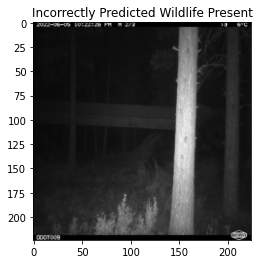

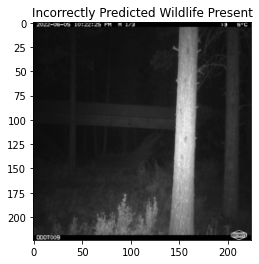

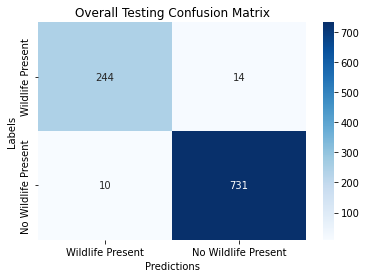

Overall Accuracy: 0.975975975975976
Overall Precision: 0.9606299212598425
Overall Recall: 0.9457364341085271
Overall F-Score: 0.9531249999999999


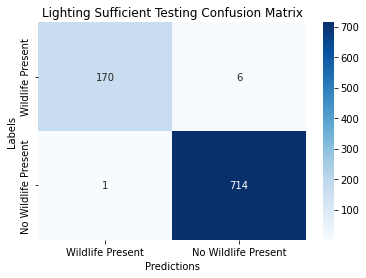

Lighting Sufficient Accuracy: 0.9921436588103255
Lighting Sufficient Precision: 0.9941520467836257
Lighting Sufficient Recall: 0.9659090909090909
Lighting Sufficient F-Score: 0.9798270893371758


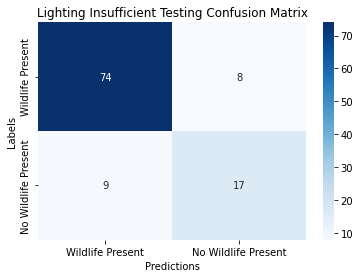

Lighting Insufficient Accuracy: 0.8425925925925926
Lighting Insufficient Precision: 0.891566265060241
Lighting Insufficient Recall: 0.9024390243902439
Lighting Insufficient F-Score: 0.896969696969697


In [ ]:
train_and_test_ResNet50(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes)


Training and Testing ResNet152


Downloading: "https://download.pytorch.org/models/resnet152-f82ba261.pth" to /root/.cache/torch/hub/checkpoints/resnet152-f82ba261.pth


  0%|          | 0.00/230M [00:00<?, ?B/s]

epoch: 0
training loss: 0.05906348384964032 and training accuracy: 0.8721628838451269
testing loss: 0.011248482638868402 and testing accuracy: 0.95995995995996
epoch: 1
training loss: 0.010935008002445724 and training accuracy: 0.9546061415220294
testing loss: 0.008245331738647577 and testing accuracy: 0.9629629629629629
epoch: 2
training loss: 0.006850280116663628 and training accuracy: 0.9699599465954606
testing loss: 0.005993442140748954 and testing accuracy: 0.972972972972973
epoch: 3
training loss: 0.004847080184728683 and training accuracy: 0.9803070761014686
testing loss: 0.005742597240539551 and testing accuracy: 0.977977977977978
epoch: 4
training loss: 0.003517397039696821 and training accuracy: 0.9869826435246996
testing loss: 0.00630311952517622 and testing accuracy: 0.972972972972973


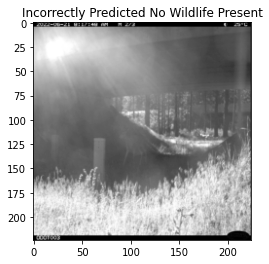

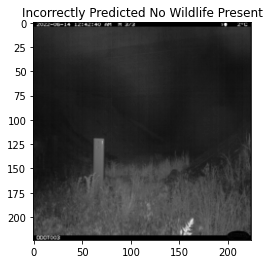

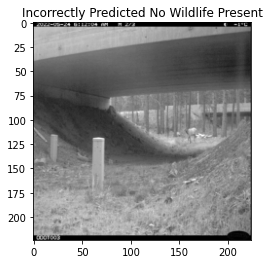

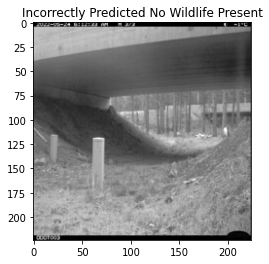

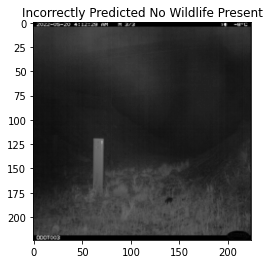

...

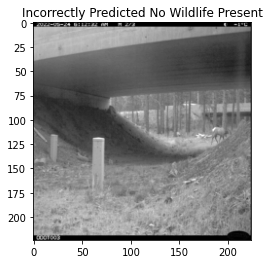

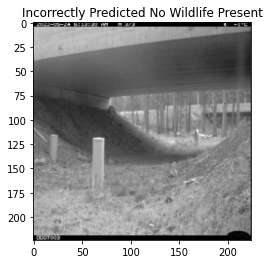

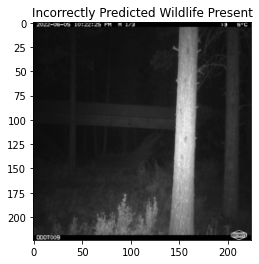

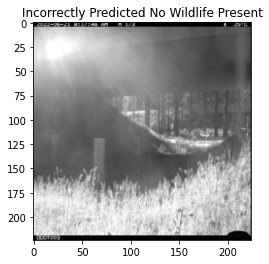

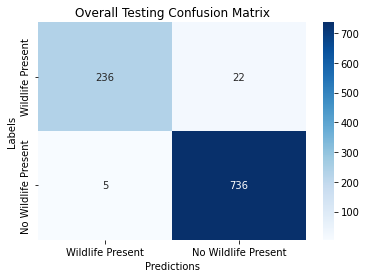

Overall Accuracy: 0.972972972972973
Overall Precision: 0.979253112033195
Overall Recall: 0.9147286821705426
Overall F-Score: 0.9458917835671342


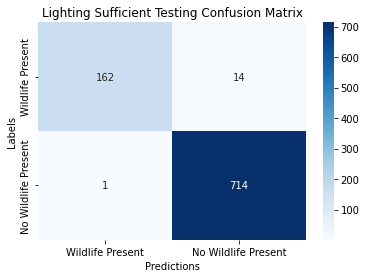

Lighting Sufficient Accuracy: 0.9831649831649831
Lighting Sufficient Precision: 0.9938650306748467
Lighting Sufficient Recall: 0.9204545454545454
Lighting Sufficient F-Score: 0.9557522123893806


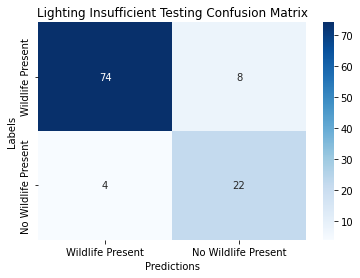

Lighting Insufficient Accuracy: 0.8888888888888888
Lighting Insufficient Precision: 0.9487179487179487
Lighting Insufficient Recall: 0.9024390243902439
Lighting Insufficient F-Score: 0.9249999999999999


In [ ]:
train_and_test_ResNet152(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes)


Training and Testing AlexNet


Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth


  0%|          | 0.00/233M [00:00<?, ?B/s]

epoch: 0
training loss: 0.053173600506682385 and training accuracy: 0.8544726301735648
testing loss: 0.01800435862398601 and testing accuracy: 0.950950950950951
epoch: 1
training loss: 0.020642262550232875 and training accuracy: 0.9195594125500668
testing loss: 0.018405225818386644 and testing accuracy: 0.933933933933934
epoch: 2
training loss: 0.016615619073143677 and training accuracy: 0.9402536715620827
testing loss: 0.014533203367299555 and testing accuracy: 0.954954954954955
epoch: 3
training loss: 0.015920311322213318 and training accuracy: 0.9469292389853138
testing loss: 0.01796043651818006 and testing accuracy: 0.9469469469469469
epoch: 4
training loss: 0.014663191662758753 and training accuracy: 0.94826435246996
testing loss: 0.013334351894166041 and testing accuracy: 0.953953953953954


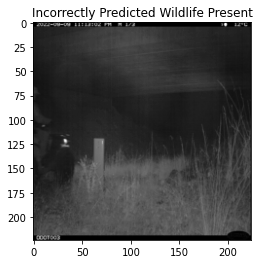

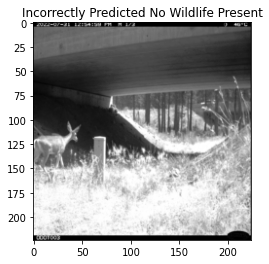

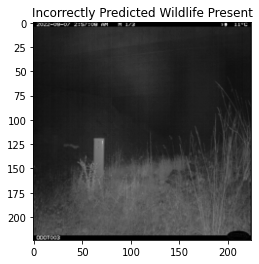

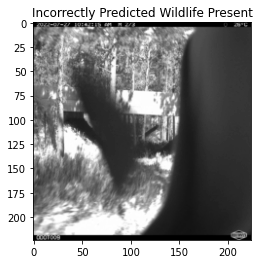

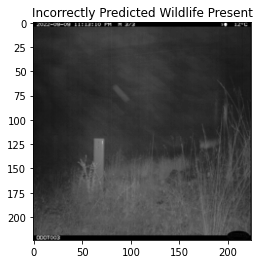

...

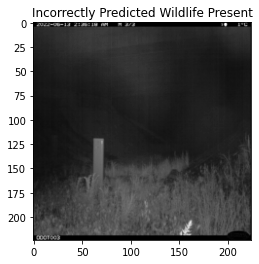

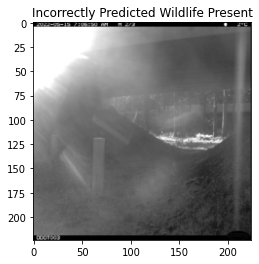

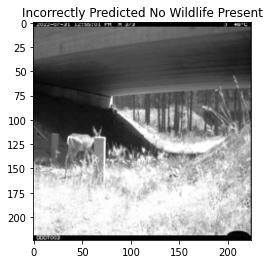

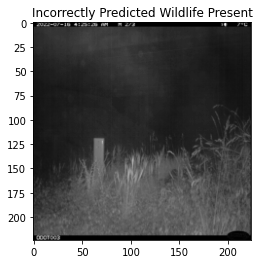

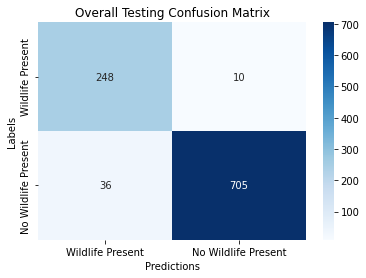

Overall Accuracy: 0.953953953953954
Overall Precision: 0.8732394366197183
Overall Recall: 0.9612403100775194
Overall F-Score: 0.9151291512915128


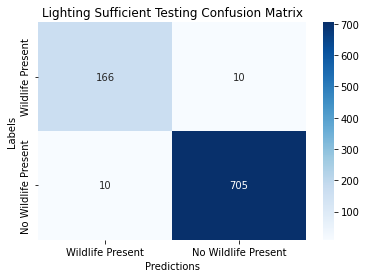

Lighting Sufficient Accuracy: 0.9775533108866442
Lighting Sufficient Precision: 0.9431818181818182
Lighting Sufficient Recall: 0.9431818181818182
Lighting Sufficient F-Score: 0.9431818181818182


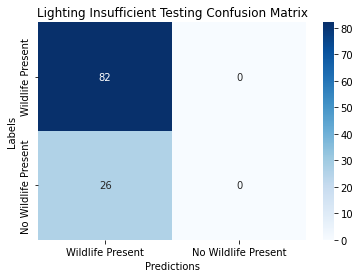

Lighting Insufficient Accuracy: 0.7592592592592593
Lighting Insufficient Precision: 0.7592592592592593
Lighting Insufficient Recall: 1.0
Lighting Insufficient F-Score: 0.8631578947368421


In [ ]:
train_and_test_AlexNet(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes)


Training and Testing Vision Transformer Base 16
epoch: 0
training loss: 0.029333549330997355 and training accuracy: 0.9125500667556742
testing loss: 0.02012884330836025 and testing accuracy: 0.9329329329329329
epoch: 1
training loss: 0.015029081425404031 and training accuracy: 0.9432576769025367
testing loss: 0.014851799104931401 and testing accuracy: 0.950950950950951
epoch: 2
training loss: 0.012169737745666188 and training accuracy: 0.9539385847797063
testing loss: 0.012402451438175558 and testing accuracy: 0.948948948948949
epoch: 3
training loss: 0.010112099504834129 and training accuracy: 0.9639519359145527
testing loss: 0.013627250457310246 and testing accuracy: 0.9459459459459459
epoch: 4
training loss: 0.008726801141587765 and training accuracy: 0.9689586114819759
testing loss: 0.01429044800267827 and testing accuracy: 0.943943943943944


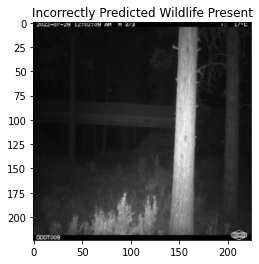

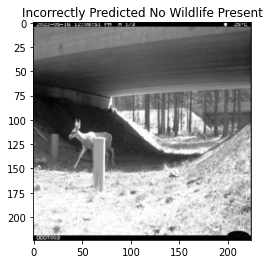

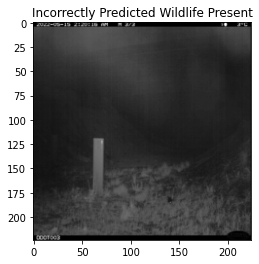

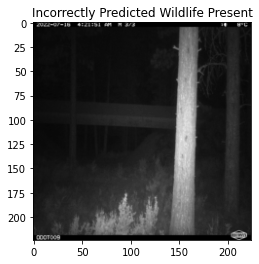

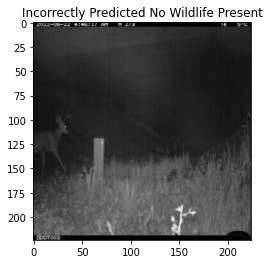

...

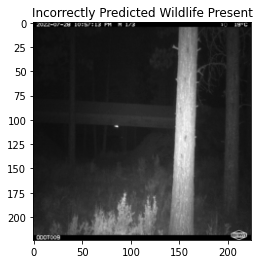

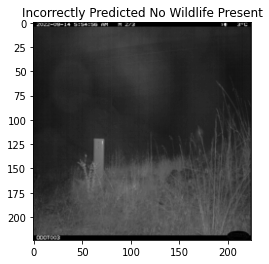

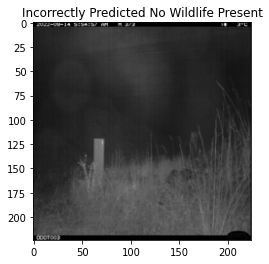

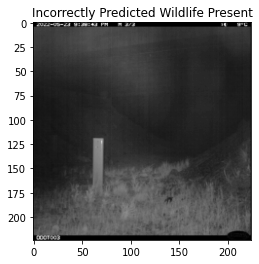

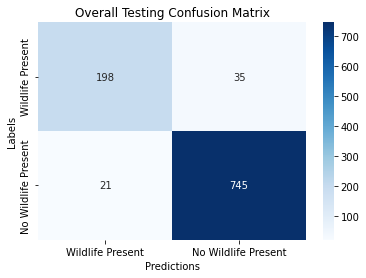

Overall Accuracy: 0.943943943943944
Overall Precision: 0.9041095890410958
Overall Recall: 0.8497854077253219
Overall F-Score: 0.8761061946902654


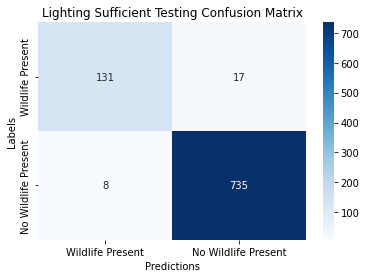

Lighting Sufficient Accuracy: 0.9719416386083053
Lighting Sufficient Precision: 0.9424460431654677
Lighting Sufficient Recall: 0.8851351351351351
Lighting Sufficient F-Score: 0.9128919860627178


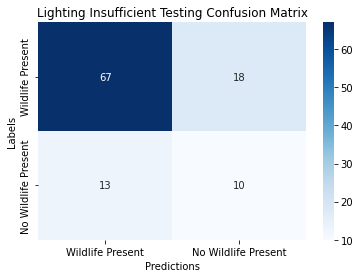

Lighting Insufficient Accuracy: 0.7129629629629629
Lighting Insufficient Precision: 0.8375
Lighting Insufficient Recall: 0.788235294117647
Lighting Insufficient F-Score: 0.8121212121212121


In [14]:
train_and_test_ViT_B_16(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes)


Training and Testing Vision Transformer Base 32


Downloading: "https://download.pytorch.org/models/vit_b_32-d86f8d99.pth" to /root/.cache/torch/hub/checkpoints/vit_b_32-d86f8d99.pth


  0%|          | 0.00/337M [00:00<?, ?B/s]

epoch: 0
training loss: 0.033422006556182327 and training accuracy: 0.8838451268357811
testing loss: 0.017236294794465985 and testing accuracy: 0.9369369369369369
epoch: 1
training loss: 0.019714072559331792 and training accuracy: 0.9292389853137517
testing loss: 0.02120867167529347 and testing accuracy: 0.914914914914915
epoch: 2
training loss: 0.015864337573386855 and training accuracy: 0.9429238985313751
testing loss: 0.014406812294536421 and testing accuracy: 0.943943943943944
epoch: 3
training loss: 0.014418655929567297 and training accuracy: 0.9499332443257676
testing loss: 0.013054255489353184 and testing accuracy: 0.950950950950951
epoch: 4
training loss: 0.012717819603730288 and training accuracy: 0.9549399198931909
testing loss: 0.013319384274506444 and testing accuracy: 0.948948948948949


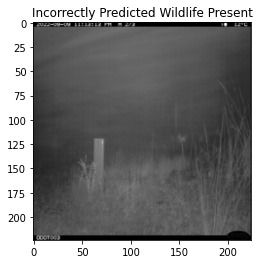

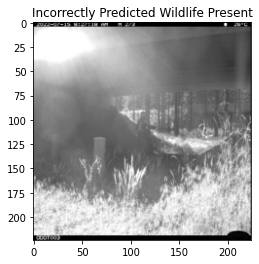

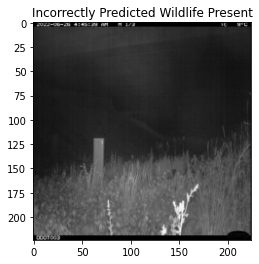

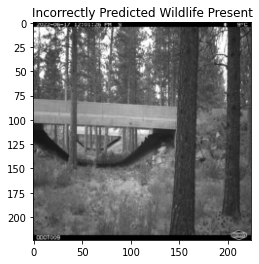

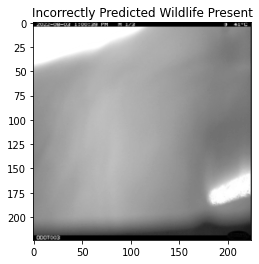

...

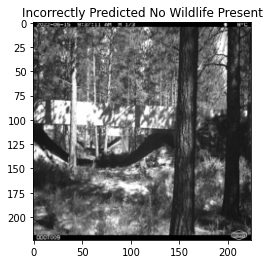

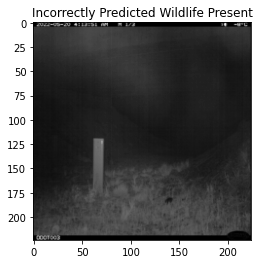

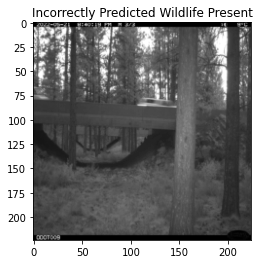

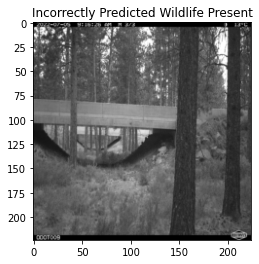

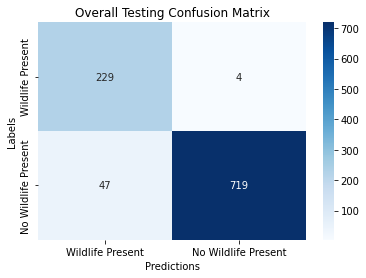

Overall Accuracy: 0.948948948948949
Overall Precision: 0.8297101449275363
Overall Recall: 0.9828326180257511
Overall F-Score: 0.899803536345776


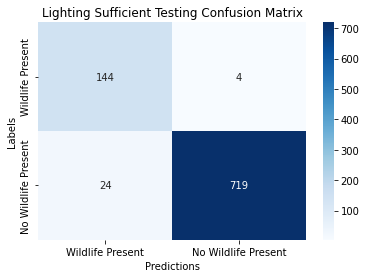

Lighting Sufficient Accuracy: 0.9685746352413019
Lighting Sufficient Precision: 0.8571428571428571
Lighting Sufficient Recall: 0.972972972972973
Lighting Sufficient F-Score: 0.9113924050632912


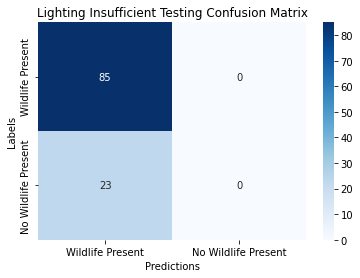

Lighting Insufficient Accuracy: 0.7870370370370371
Lighting Insufficient Precision: 0.7870370370370371
Lighting Insufficient Recall: 1.0
Lighting Insufficient F-Score: 0.8808290155440415


In [15]:
train_and_test_ViT_B_32(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes)


Training and Testing Vision Transformer Large 16


Downloading: "https://download.pytorch.org/models/vit_l_16-852ce7e3.pth" to /root/.cache/torch/hub/checkpoints/vit_l_16-852ce7e3.pth


  0%|          | 0.00/1.13G [00:00<?, ?B/s]

epoch: 0
training loss: 0.028396122361106228 and training accuracy: 0.9242323097463284
testing loss: 0.011100621250513065 and testing accuracy: 0.9579579579579579
epoch: 1
training loss: 0.007726318498405086 and training accuracy: 0.9686248331108144
testing loss: 0.00723132515350381 and testing accuracy: 0.96996996996997
epoch: 2
training loss: 0.005776194883319489 and training accuracy: 0.9813084112149533
testing loss: 0.009206103611839106 and testing accuracy: 0.964964964964965
epoch: 3
training loss: 0.003680438355804071 and training accuracy: 0.9879839786381842
testing loss: 0.007574124011601246 and testing accuracy: 0.965965965965966
epoch: 4
training loss: 0.0027989093254842503 and training accuracy: 0.9889853137516689
testing loss: 0.007606392304107241 and testing accuracy: 0.973973973973974


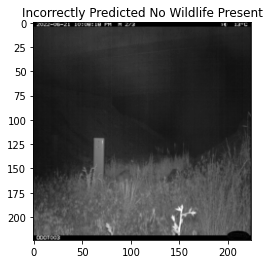

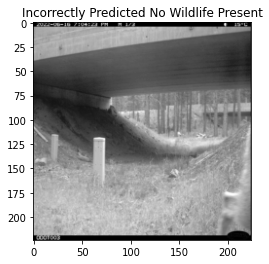

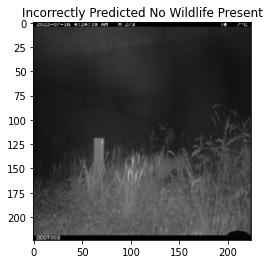

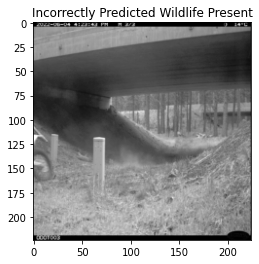

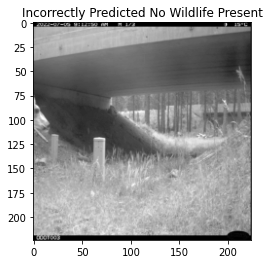

...

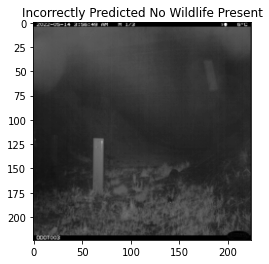

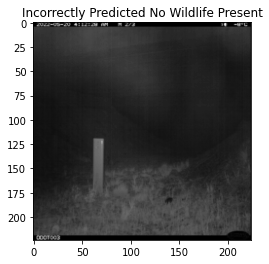

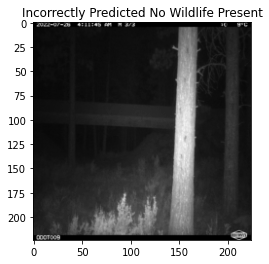

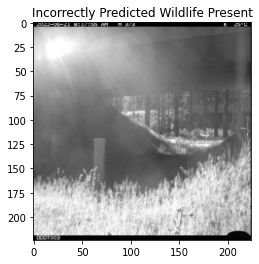

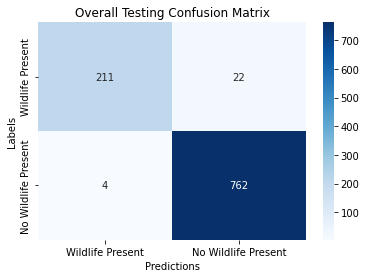

Overall Accuracy: 0.973973973973974
Overall Precision: 0.9813953488372092
Overall Recall: 0.9055793991416309
Overall F-Score: 0.9419642857142857


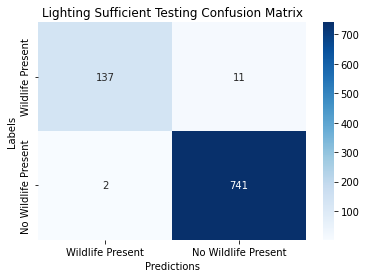

Lighting Sufficient Accuracy: 0.9854096520763187
Lighting Sufficient Precision: 0.9856115107913669
Lighting Sufficient Recall: 0.9256756756756757
Lighting Sufficient F-Score: 0.9547038327526132


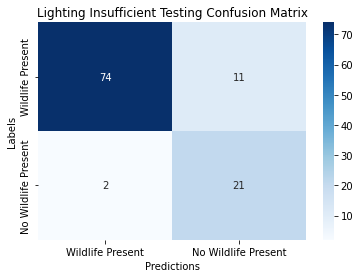

Lighting Insufficient Accuracy: 0.8796296296296297
Lighting Insufficient Precision: 0.9736842105263158
Lighting Insufficient Recall: 0.8705882352941177
Lighting Insufficient F-Score: 0.9192546583850931


In [16]:
train_and_test_ViT_L_16(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes)


Training and Testing Vision Transformer Large 32


Downloading: "https://download.pytorch.org/models/vit_l_32-c7638314.pth" to /root/.cache/torch/hub/checkpoints/vit_l_32-c7638314.pth


  0%|          | 0.00/1.14G [00:00<?, ?B/s]

epoch: 0
training loss: 0.03439271241777424 and training accuracy: 0.9058744993324432
testing loss: 0.013708711962576385 and testing accuracy: 0.953953953953954
epoch: 1
training loss: 0.013465645409663841 and training accuracy: 0.9489319092122831
testing loss: 0.012906193083433716 and testing accuracy: 0.9519519519519519
epoch: 2
training loss: 0.011264350663227335 and training accuracy: 0.9576101468624834
testing loss: 0.0142413246409466 and testing accuracy: 0.943943943943944
epoch: 3
training loss: 0.010088989793311168 and training accuracy: 0.9589452603471295
testing loss: 0.01223431457742094 and testing accuracy: 0.9479479479479479
epoch: 4
training loss: 0.009345610985536367 and training accuracy: 0.9606141522029372
testing loss: 0.011100339513081868 and testing accuracy: 0.9529529529529529


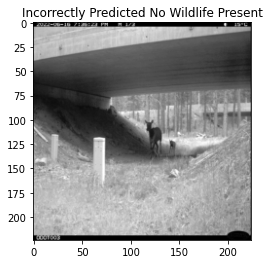

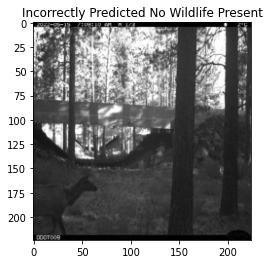

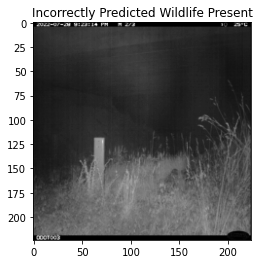

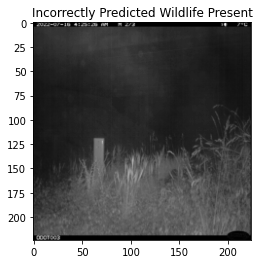

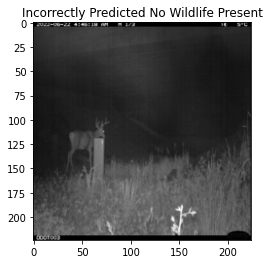

...

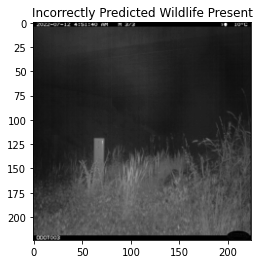

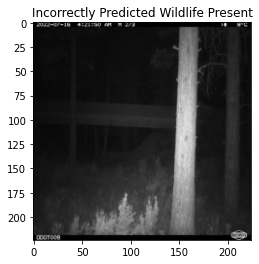

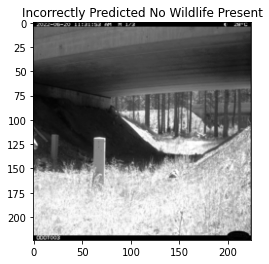

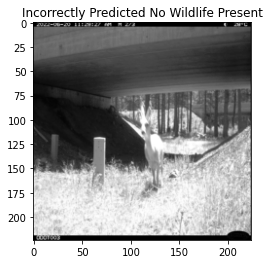

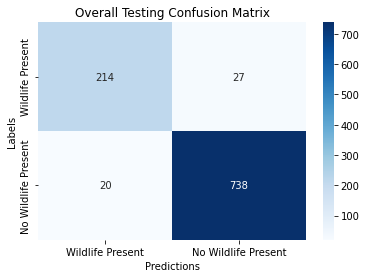

Overall Accuracy: 0.9529529529529529
Overall Precision: 0.9145299145299145
Overall Recall: 0.8879668049792531
Overall F-Score: 0.9010526315789473


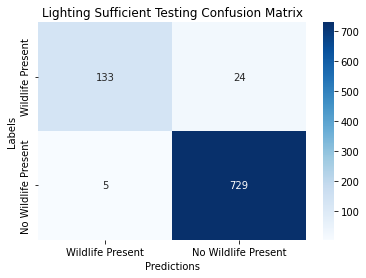

Lighting Sufficient Accuracy: 0.9674523007856342
Lighting Sufficient Precision: 0.9637681159420289
Lighting Sufficient Recall: 0.8471337579617835
Lighting Sufficient F-Score: 0.9016949152542373


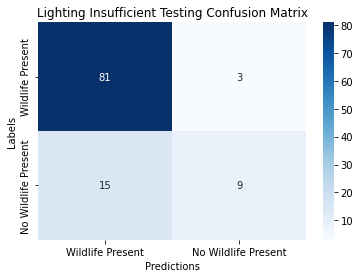

Lighting Insufficient Accuracy: 0.8333333333333334
Lighting Insufficient Precision: 0.84375
Lighting Insufficient Recall: 0.9642857142857143
Lighting Insufficient F-Score: 0.8999999999999999


In [10]:
train_and_test_ViT_L_32(training_loader, testing_loader, ls_testing_loader, lis_testing_loader, device, num_classes)